#**Project Name : Sentiment Analysis**

##**Problem Statement:**

The task at hand involves sentiment analysis on the IMDb dataset, which comprises 50,000 movie reviews. These reviews serve as a rich source of data for natural language processing and text analytics tasks. The dataset is structured for binary sentiment classification, offering a considerably larger volume of data compared to previous benchmark datasets. It consists of 25,000 movie reviews designated for training purposes and an additional 25,000 reviews for testing. The objective of this project is to predict the sentiment of movie reviews, distinguishing between positive and negative sentiments. This prediction can be accomplished through the implementation of various classification algorithms or deep learning techniques. By leveraging the abundance of labeled data in the IMDb dataset, the goal is to develop a model capable of accurately categorizing movie reviews based on their sentiment. This model holds potential applications in sentiment analysis tasks across diverse domains, including market research, customer feedback analysis, and opinion mining in social media platforms.

###**Import libraries**

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud
import re
from nltk.corpus import wordnet
from nltk.stem import WordNetLemmatizer
from collections import Counter
from bs4 import BeautifulSoup
import nltk
from nltk.util import ngrams
from collections import Counter
from nltk.corpus import stopwords
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import MultinomialNB
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix, roc_curve, roc_auc_score,auc, classification_report
from transformers import BertTokenizer, BertModel
import torch

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
df=pd.read_csv('/content/drive/MyDrive/Interview_question_solved/Machine learning /Machine Learning /Unsupervised learning/NLP and Topic Modelling/dataset/IMDB/IMDB Dataset.csv')

In [ ]:
df.head()

,review,sentiment
0,One of the other reviewers has mentioned that ...,positive
1,A wonderful little production. <br /><br />The...,positive
2,I thought this was a wonderful way to spend ti...,positive
3,Basically there's a family where a little boy ...,negative
4,"Petter Mattei's ""Love in the Time of Money"" is...",positive


In [ ]:
df.reset_index(inplace=True)

In [ ]:
print(len(df['review'].value_counts()))
print('\n')
print(df['sentiment'].value_counts())

49582


positive    25000
negative    25000
Name: sentiment, dtype: int64


In [ ]:
print(df['review'].value_counts())

Loved today's show!!! It was a variety and not solely cooking (which would have been great too). Very stimulating and captivating, always keeping the viewer peeking around the corner to see what was coming up next. She is as down to earth and as personable as you get, like one of us which made the show all the more enjoyable. Special guests, who are friends as well made for a nice surprise too. Loved the 'first' theme and that the audience was invited to play along too. I must admit I was shocked to see her come in under her time limits on a few things, but she did it and by golly I'll be writing those recipes down. Saving time in the kitchen means more time with family. Those who haven't tuned in yet, find out what channel and the time, I assure you that you won't be disappointed.                                                                                                                                                                                                                

##**EDA**

In [ ]:
df['review_length'] = df['review'].apply(len)

In [ ]:
# Concatenate all reviews into a single string
text = ' '.join(df['review'])

In [ ]:
# Generate a word cloud
wordcloud = WordCloud(width=800, height=400, random_state=21, max_font_size=110, background_color='white').generate(text)

###**Sentiment Distribution**

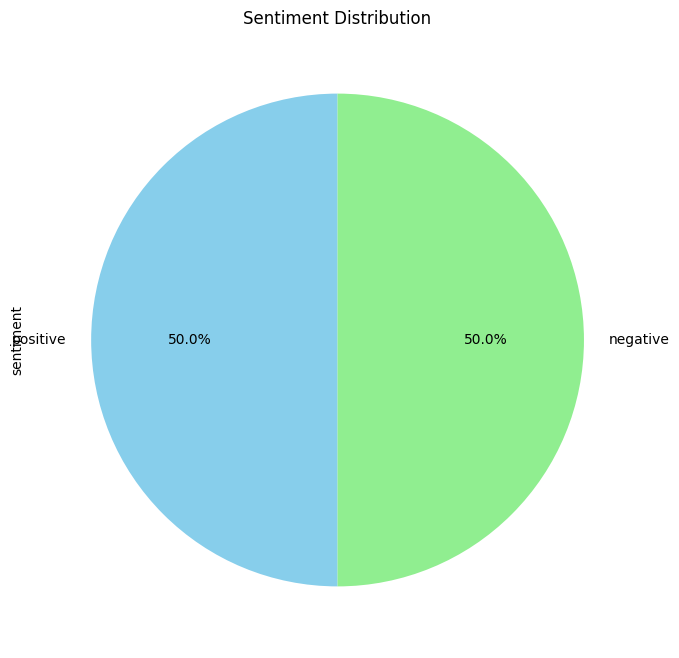

In [ ]:
# Plot 1: Pie Chart of Sentiment Distribution
plt.figure(figsize=(8, 8))
df['sentiment'].value_counts().plot.pie(autopct='%1.1f%%', startangle=90, colors=['skyblue', 'lightgreen', 'lightcoral'])
plt.title('Sentiment Distribution')
plt.show()

*   Positive sentiment: 50.0%
*   Negative sentiment: 50.0%

 The sentiment is equally divided between positive and negative in this group.  This could indicate neutrality or mixed feelings on the topic being measured.


###**Histogram of Review Lengths**

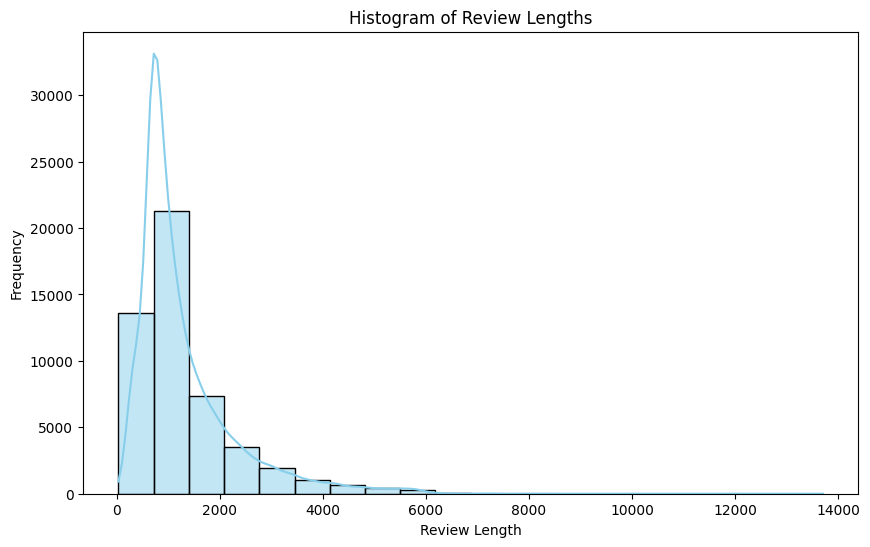

In [ ]:
# Plot 2: Histogram of Review Lengths
plt.figure(figsize=(10, 6))
sns.histplot(df['review_length'], bins=20, kde=True, color='skyblue')
plt.title('Histogram of Review Lengths')
plt.xlabel('Review Length')
plt.ylabel('Frequency')
plt.show()


*   Most reviews are short: The histogram appears to have a peak at the lower end of the x-axis, which suggests that most reviews are relatively short in length. There isn't enough information to determine the exact length corresponding to the peak, but it appears to be less than 2000 characters.
*   Longer reviews exist, but less frequent: The histogram tail extends to the right side of the x-axis, indicating that there are some reviews that are much longer than the most frequent lengths. However, these longer reviews appear to be less frequent than shorter reviews.

*   Users might prefer to write concise reviews, and the platform might have a character limit that cuts off reviews at a certain length.

*   Longer reviews might take more time and effort to write, so users are less likely to do so.

*   Users might write short reviews for positive experiences and longer reviews for negative experiences (or vice versa).List item


###**WordCloud image**

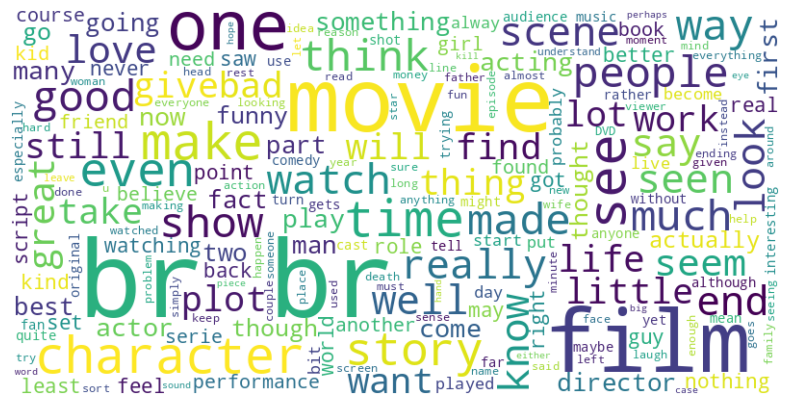

In [ ]:
# Plot 3 the WordCloud image
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis('off')
plt.show()

*   words include "fun", "good", "funny", "love", "see", "watch", "characters", "story", "enjoyed". These words suggest that the movie is entertaining, enjoyable, and has good characters and story.
*   words include "family", "comedy", "acting", "performance", "director", "possibly", "laugh", "thought provoking". These suggest the movie might be a comedy or family film with good acting and directing.

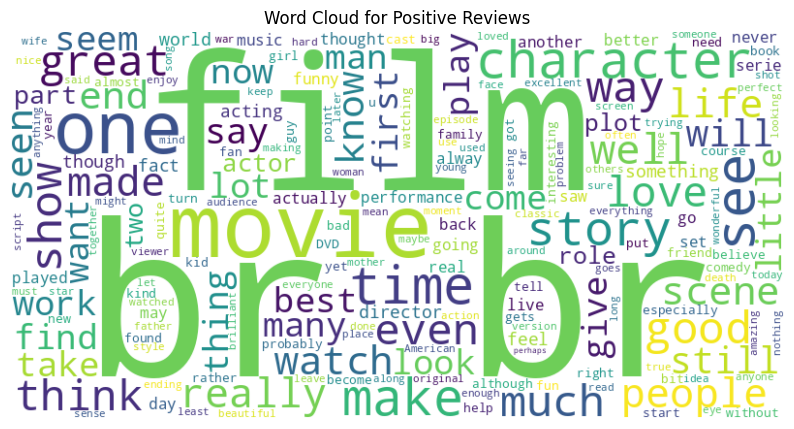

In [ ]:
# Plot 4: Word Cloud for Positive Reviews
positive_reviews = ' '.join(df[df['sentiment'] == 'positive']['review'])
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(positive_reviews)
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud for Positive Reviews')
plt.show()

*   Positive words: The word cloud is dominated by positive words related to movies, such as "great", "excellent", "loved", "amazing", "perfect", "enjoyed", "well-made", "brilliant", and "fantastic". This suggests that the reviews are generally positive.
*   Specific aspects: Some words highlight specific aspects that viewers liked, such as "acting", "story", "plot", "characters", "comedy", "laughs", "hilarious", "action", " trzymający w napięciu" (which translates to "gripping" in Polish), and "effects". These words suggest that reviewers enjoyed the movie's acting, story, humor, action sequences

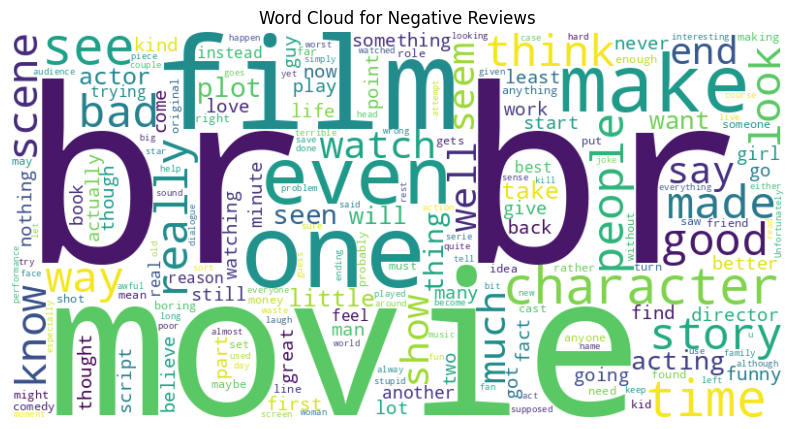

In [ ]:
# Plot 5 Word Cloud for Negative Reviews
negative_reviews = ' '.join(df[df['sentiment'] == 'negative']['review'])
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(negative_reviews)
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud for Negative Reviews')
plt.show()

*   Specific criticisms: Many words point to specific aspects that viewers disliked. These include "acting", "characters", "plot", "story", "writing", "dialogue", "boring", "predictable", "unoriginal", "cliché", "unfunny", "effects", and "waste". Reviewers seem to dislike the movie's acting, characters, plot, story development, dialogue, humor, and special effects
*   Negative sentiment: Words like "disappointed", "terrible", "awful", "boring", "unnecessary", "predictable", "waste", "avoid", "terrible", "worst" and "cliché" dominate the word cloud, indicating a strong negative sentiment towards the movie.

<ipython-input-16-0ec649d39527>:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='sentiment', y='review_length', data=df, palette='pastel')


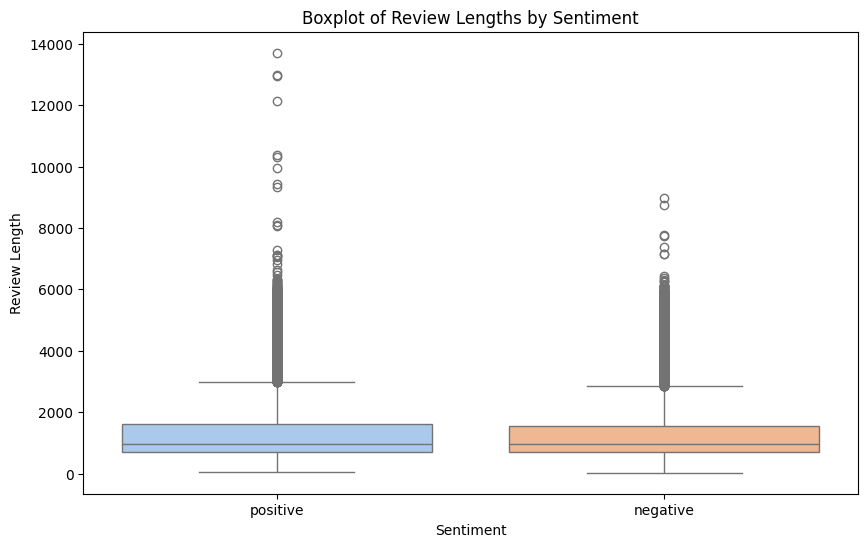

In [ ]:
# Plot 6: Boxplot of Review Lengths by Sentiment
plt.figure(figsize=(10, 6))
sns.boxplot(x='sentiment', y='review_length', data=df, palette='pastel')
plt.title('Boxplot of Review Lengths by Sentiment')
plt.xlabel('Sentiment')
plt.ylabel('Review Length')
plt.show()

*   reviews tend to be shorter for positive sentiment and longer for negative sentiment. The median length (the line in the middle of the box) for positive reviews is lower than the median for negative reviews. The boxes themselves, which represent the middle 50% of the data, are also shorter for positive sentiment. This suggests that people tend to write shorter reviews when they have a positive opinion about a product and write longer reviews when they have a negative opinion.

##**Text Preprocessing**

###**Check html tags**

In [ ]:
# Check if HTML tags are present in the 'review' column
html_tags_present = df['review'].str.contains(r'<[^>]+>').any()

if html_tags_present:
    print("HTML tags are present in the 'review' column.")
else:
    print("No HTML tags found in the 'review' column.")

# Print the lines where HTML tags are found
lines_with_html_tags = df[df['review'].str.contains(r'<[^>]+>')].index.tolist()
if lines_with_html_tags:
    print("HTML tags exist in the following lines:", lines_with_html_tags)
    # Print the corresponding review texts containing HTML tags
    for line_number in lines_with_html_tags:
        print("Line:", line_number, "->", df.loc[line_number, 'review'])
else:
    print("No HTML tags found in the text.")

HTML tags are present in the 'review' column.
HTML tags exist in the following lines: [0, 1, 2, 3, 4, 7, 8, 9, 10, 11, 12, 13, 17, 20, 21, 23, 24, 25, 26, 27, 29, 30, 31, 33, 35, 37, 38, 40, 41, 42, 43, 44, 45, 48, 49, 50, 51, 52, 54, 55, 56, 58, 59, 61, 62, 64, 65, 66, 69, 72, 74, 76, 77, 79, 81, 82, 83, 84, 86, 88, 89, 90, 91, 92, 95, 96, 98, 99, 101, 102, 104, 110, 112, 113, 119, 122, 124, 126, 129, 131, 133, 134, 135, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 149, 151, 153, 154, 156, 157, 161, 163, 164, 166, 167, 168, 169, 170, 171, 172, 173, 174, 177, 179, 181, 182, 183, 185, 186, 189, 190, 191, 195, 196, 197, 198, 199, 200, 202, 204, 208, 210, 212, 213, 214, 216, 217, 218, 219, 220, 221, 223, 224, 225, 228, 234, 235, 238, 239, 243, 244, 249, 250, 251, 253, 255, 257, 258, 259, 260, 261, 262, 263, 266, 267, 268, 272, 273, 275, 276, 277, 280, 281, 282, 283, 284, 288, 291, 292, 293, 295, 297, 298, 303, 305, 306, 309, 310, 314, 316, 318, 319, 320, 322, 323, 325, 326, 328, 333,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 -> This is one of the greatest films I have ever seen: I glowed inside throughout the whole film. The music and cinematography held the spell when little was happening on screen. The slow pace was set by the mode of travel (a riding lawn mower with a big trailer) and was maintained by the background sights and sounds and the slow-paced lives of the other characters.<br /><br />The story actually happened; Alvin Straight died in 1996 at the age of 76. There was no acting; everything was completely real, as if the actors had actually transformed into the characters. Sissy Spacek gave a poignant performance as a somewhat disabled daughter who had suffered much but forged ahead, always wanting to do the right thing. Richard Farnsworth was cast perfectly and he beautifully became Alvin Straight, a stubborn but loving elderly man who treks across Iowa to visit his estranged brother, Lyle, who has had a stroke. Alvin had learned much wisdom during his life and that seemed to bring out the be

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 18217 -> The plot of 'Edison' was decent, but one actor in particular ruined the entire film. Justin Timberlake ruined the film with every line he uttered during the movie. He is by far one of the worst actors I have ever seen, and should face the same fate as the entire F.R.A.T. squad. <br /><br />Whether it was an emotional scene, an action scene, or even a silent scene, Justin Timberlake managed to ruin it. <br /><br />Do not waste your time watching this film. Don't even bother downloading it, midget porn would be a much better choice.<br /><br />And Justin, if you're reading this, stick to music. Even though you're no good at that, you've done a wonderful job tricking people into thinking you can actually sing.
Line: 18219 -> By all accounts, this could have been an interesting film. Featuring a score by the mighty Cradle Of Filth, starring their frontman Dani and being hyped up as "the future of British horror", I expected Alex Chandon's gore fest to live up to the hype.<br /><b

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 -> This truly is an Australia cult classic. If you're one of the lucky ones to have seen it-- then you are very lucky. It has been released in most countries, but not in Australia for some reason. I have a copy on DVD from the UK. Not a great transfer, but I bought it, having seen it previously at a film festival. The directing is spot on and the performances rock! This is dark film scary film, but often times, very funny in parts. I urge you to see this film, there is a coolness about this you don't see in 99% of the typical Aussie fare. The screenplay is very well crafted and sends you on a journey where you know it will end badly, but until the last ten minutes, you just can't pick how badly. Great work from the four leads, especially Lachy Hulme. <br /><br />When its all said and done: Great work on display!
Line: 20593 -> Cillian Murphy and Rachel McAdams star in this action/thriller written and directed by the master of suspense, Wes Craven, himself. The whole movie starts with 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 There are few uplifting things to say about this, but I can mention Matt Dillon doing his best to make something out of nothing and the many split screens and graphics that are worthwhile. As most race movies suffer from the premise that car lovers are not that intelligent, we end up with movies like this.<br /><br />Lindsay Lohan who surprised so much in Mean Girls has to make better decisions which roles to take. Here she can only fail.<br /><br />Children will only be mildly entertained because it tries to appeal more to adults than children (although still pretty dumb). The ones in the theater I saw it with showed no real interest after a couple of minutes. And as a family sports movie this is horrible. The better moments are in the beginning at the scrapyard creating some sentiment and later in the car-bash fest creating some tension. If you develop a car as a central character you have to develop it better than here. After a few obligatory race scenes you are in for the best par

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 -> A movie/documentary about different people in Austria on the hottest weekend of the year. It follows what they are doing and maybe more what they are not doing. The tempo is very quiet......so you have to relax.......breathe in...breathe out before you see it......<br /><br />First you think....but nothing is happening and you get a little angry over that..and thats the problem, because its the mood of the film and the really nice social realistic pictures which are nice in this film...........a lot of people will say its disgusting......but its not that bad...i think its more used for the marketing....and theres some really funny moments...a 60 old woman stripping.....i guarantee its the most unsexy striptease in film history......its movie which is real..i think thats the word......right up in your face.......and that makes it a bit scary.no computer manipulation here.....its real life...and as we all know movies can win over reality when it comes to doing sick things..........so

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



###**Remove html tags**

In [ ]:
# Function to remove HTML tags
def remove_html_tags(text):
    soup = BeautifulSoup(text, "html.parser")
    return soup.get_text()
# Apply the function to the 'review' column
df['review'] = df['review'].apply(remove_html_tags)

<ipython-input-18-a1b58a503eaa>:3: MarkupResemblesLocatorWarning: The input looks more like a filename than markup. You may want to open this file and pass the filehandle into Beautiful Soup.
  soup = BeautifulSoup(text, "html.parser")


###**Check punctuation**

In [ ]:
def has_punctuation(text):
    # Define a regular expression pattern to match punctuation
    punctuation_pattern = r'[^\w\s]'
    # Search for punctuation in the text
    if re.search(punctuation_pattern, text):
        return True
    else:
        return False

# Apply has_punctuation function to each review in the 'review' column
punctuation_exists = df['review'].apply(has_punctuation)

# Check if punctuation exists in any review
if punctuation_exists.any():
    print("Punctuation exists in at least one review.")
else:
    print("No punctuation found in any review.")

Punctuation exists in at least one review.


###**Remove Punctuation**

In [ ]:
def has_punctuation(text):
    # Define a regular expression pattern to match punctuation
    punctuation_pattern = r'[^\w\s]'
    # Search for punctuation in the text
    if re.search(punctuation_pattern, text):
        return True
    else:
        return False

# Apply has_punctuation function to each review in the 'review' column
punctuation_exists = df['review'].apply(has_punctuation)

# Check if punctuation exists in any review
if punctuation_exists.any():
    print("Punctuation exists in the following rows:")
    # Print the indices of rows where punctuation exists
    rows_with_punctuation = df.index[punctuation_exists].tolist()
    for row_index in rows_with_punctuation:
        print("Row:", row_index, "->", df.loc[row_index, 'review'])
else:
    print("No punctuation found in any review.")

Punctuation exists in the following rows:
Row: 0 -> One of the other reviewers has mentioned that after watching just 1 Oz episode you'll be hooked. They are right, as this is exactly what happened with me.The first thing that struck me about Oz was its brutality and unflinching scenes of violence, which set in right from the word GO. Trust me, this is not a show for the faint hearted or timid. This show pulls no punches with regards to drugs, sex or violence. Its is hardcore, in the classic use of the word.It is called OZ as that is the nickname given to the Oswald Maximum Security State Penitentary. It focuses mainly on Emerald City, an experimental section of the prison where all the cells have glass fronts and face inwards, so privacy is not high on the agenda. Em City is home to many..Aryans, Muslims, gangstas, Latinos, Christians, Italians, Irish and more....so scuffles, death stares, dodgy dealings and shady agreements are never far away.I would say the main appeal of the show i

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



6768 -> Kazuo Komizu strikes again with "Entrails of a Beautiful Woman", the sequel to "Entrails of a Virgin". This time around the story is based around a psychologist (Megumi Ozawa) who decides to take on the Yakuza to avenge the suicide of a doped-up and raped patient that winds up on her doorstep one day. When she gets over her head and the Yakuza capture her, she learns their insidious plat of doping up girls and selling them into slavery. It apparently ends badly when she overdoses from the cocaine. But she soon melds with another body to be disposed of to becomedum, dum, dum  "Super Slime Hermaphrodite Zord"! This he, she = it makes mince meat out of the yakuza and saves the daynot really.Well it is better than "Entrails of a Virgin", but not by much. Most of the film (a whopping 67 minutes) consists of rape and sex with fogging and the usual ho-hum stuff. Almost towards the end we finally get our gore groove on with a few cool sequence (like an Alien-inspired penis-monster t

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 19303 -> A year or so ago, I was watching the TV news when a story was broadcast about a zombie movie being filmed in my area. Since then I have paid particular attention to this movie called 'Fido' as it finished production and began playing at festivals. Two weeks ago Fido began playing in my local theater. And, just yesterday, I read a newspaper article which stated Fido is not attracting audiences in it's limited release, with the exception of our local theater. In fact, here it is outdrawing all other shows at The Paramount Theater, including 300. Of course, this makes sense as many locals want to see their city on screen or spot themselves roaming around in zombie make-up. And for any other locals who haven't seen Fido yet but are considering it, I can say there are many images on screen, from the school to city park to the forbidden zone, that you will recognize. In fact, they make the Okanagan Valley look beautiful. That's right beautiful scenery in a zombie movie! However, Fi

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Row: 25611 -> DarkWolf tells the tale of a young waitress named Josie (Samaire Armstrong) who had been leading a pretty ordinary life until her friend Mary (Tippi Hedren) is killed by a Werewolf, you see Werewolves actually exist in modern day America & there is even a special organisation within the police force to fight the Werewolf threat headed up by Detective Steve Turley (Ryan Olosio) who has the difficult task of telling Josie that she is in fact a pure blooded Werewolf herself & that a so-called 'dark prince' Werewolf (Kane Hodder) wants to mate with her & create a new breed of pure blood Werewolves that will take over the entire world, or something like that. Understandably Josie has a hard time believing it, that is until she sees the evidence with her own eyes. It's up to Werewolf cop Steve to save Josie, the day & the world...Co-executive produced & directed Richard Friedman I thought DarkWolf was a pretty bad low budget shot on a digital camcorder horror film that didn't r

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Row: 36096 -> Three horror stories based on members of a transgressive Hindu cult that return home but changed in some way. In the first story our former cult member is now in an insane asylum and is visited by a reported who wants to find out about what went on at the cult. Somewhat slow going as story is told in flashbacks while the two sit on chairs and face each other. Reporter is particularly interested in what lead to the death of the participants. What seemed rather boring suddenly turns very exciting with a surprising twist in the story. Things get quite bloody.Second story has a violent young criminal visiting a psychiatrist for mandatory therapy. The patient seems to have some type of agenda but the psychiatrist is up to the task. Again, things slow down a bit and get weird. Then there's a strange twist in the story that is very well written and surprising.Final story deals with spiritual healer who claims to be able to remove the persons illness from them with his hands. One

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 46538 -> Just read the original story which is written by Pu in 18th century. Strikingly, the movie despict the original spirit very well, though the plot was modified tremendously. The film language, the rhythm, the special effect are all from hollywood, but still there is a chinese core. It is amazing how Hark Tsui managed to combine them together. The result is pure beauty.
Row: 46539 -> One of the many silent comedies Stan Laurel featured in before he teamed with Oliver Hardy, 'Mud and Sand' is a ho-hum hokum. The story is badly disjointed - though this could be because of the modern-day edit - and the humor itself is not at all inventive.Potential plotlines are started and ignored; for instance, Stan's promise to make Fillet de Sole pay for what she's done to him never comes to fruition. Stan's character doesn't seem very centered, either, but this is a common criticism of his work before he developed 'Stanley' of Laurel & Hardy fame, so it might be that I was just expecting to s

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



###**Check Contractions**

In [ ]:
pip install contractions

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 289.9/289.9 kB 4.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 110.8/110.8 kB 15.3 MB/s eta 0:00:00


In [ ]:
def has_contractions(text):
    # Define common contraction patterns
    contraction_patterns = ["'s", "'re", "'ve", "'d", "'ll", "'m", "'em"]
    # Check if any contraction pattern exists in the text
    for pattern in contraction_patterns:
        if pattern in text:
            return True
    return False

# Test the function
contractions_exist = df['review'].apply(has_contractions)

# Check if contractions exist in any review
if contractions_exist.any():
    print("Contractions exist in the following rows:")
    # Print the indices of rows where contractions exist
    rows_with_contractions = df.index[contractions_exist].tolist()
    for row_index in rows_with_contractions:
        print("Row:", row_index, "->", df.loc[row_index, 'review'])
else:
    print("No contractions found in any review.")

Contractions exist in the following rows:
Row: 0 -> One of the other reviewers has mentioned that after watching just 1 Oz episode you'll be hooked. They are right, as this is exactly what happened with me.The first thing that struck me about Oz was its brutality and unflinching scenes of violence, which set in right from the word GO. Trust me, this is not a show for the faint hearted or timid. This show pulls no punches with regards to drugs, sex or violence. Its is hardcore, in the classic use of the word.It is called OZ as that is the nickname given to the Oswald Maximum Security State Penitentary. It focuses mainly on Emerald City, an experimental section of the prison where all the cells have glass fronts and face inwards, so privacy is not high on the agenda. Em City is home to many..Aryans, Muslims, gangstas, Latinos, Christians, Italians, Irish and more....so scuffles, death stares, dodgy dealings and shady agreements are never far away.I would say the main appeal of the show i

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Row: 8898 -> Oh my... bad clothing, worse synth music and the worst: David Hasselhoff. The 80's are back with vengeance in Witchery, an American-Italian co-production, helmed by infamous Joe 'D'Amato on the production side and short-careered director (thank heavens for small miracles) Fabrizio Laurenti directing . Marketed as a kind of sequel to Sam Raimi's Evil Dead series in Italy (that was dubbed "La Casa" in there), Witchery delivers some modest gore groceries and bad acting.A mix of ghost story, possessions and witchcraft, the film bounces clueless from scene to another without letting some seriously wooden actors and hilarious day and night mix-ups slow it's progress to expectable ending, topped with some serious WTF surprise climax. (I just love the look on her face...) Surprisingly Laurenti manages to gather some suspense and air of malice in few - very few - scenes; unluckily for him, these few glimpses of mild movie magic go down quickly and effectively.The plus sides are ex

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



28355 -> "Shuttle" is/was more than a boring movie that had an interesting start, but after half an hour it ended in the worst imaginable way I ever could imagine. This movie has lost its story, if you can call it a story? ... after half an hour. All the next scenes are totally out of proportion. The driver is some kind of superman because he survives every attack with gun - knife etc.. even after stabbed in his leg he was able to put her in the box. But what a coincidence that there was a box in that garage. I really felt sick and misled when the movie ended. It could have been such a great one if the story was far more better. In my opinion even a kid would make a better story. And why shipping the girl with water and food. I quit with counting the plot holes about halfway through. And when the movie reached its almost admirably sick over-the-top final twist, I had completely given up (better say "throw-up). The worst thing about Shuttle is actually that it can not be even more worse

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 -> Loki, Norse god of mischief, creates a mask that endows the wearer with cartoon-like powers. At the command of his father, Odin, he spends the rest of the movie looking for the mask so that it can cause no further grief to mankind. In the meantime, the possessor of the mask conceives a child who inherits the powers of the mask. Etc. etc. If this sounds like a pretty thin plot line, it is. Add to this the fact that the movie is handled ineptly from start to finish, and the result is very, very bad. You can find worse movies, but you'll have to actively search for them.For the most part, Son of the Mask is presented at the intellectual level of a pre-schooler, but in light of scenes such as the mask-baby urinating copiously in six different directions, including on his father, this premise seems unlikely. I asked my son who he thought might have been the target audience for the movie, and he responded "Convicted felons," apparently forgetting for the moment that the Constitution proh

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 Nothing new is this tired serio-comedy that wastes the talents of Danny Glover and Whoopi Goldberg. Considering that this was produced by the stars and Spike Lee, it's pretty tame and tired stuff. And how come the Whoop never changes her hair or glasses over the many years this film covers? Blah!
Row: 39496 -> A low-rent, cheaply made police thriller that's kept bearable by some fair humorous bits, the nice chemistry between the two leads and, especially, by James Remar's satisfying turn as a narcissistic, psychopathic (and, naturally, indestructible) villain. Obviously a low-quality picture, both visually and dramatically, with a rather resigned Burt, but not unwatchable. (**)
Row: 39497 -> Anyone who has seen Ali G before, should be well prepared for the full motion picture that is 'Ali G Indahouse' Although I prefer Ali G when he is interviewing the rich and famous, his brand of completely off the wall comedy definitely entertains from start to finish on the big screen too.Ridiculo

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 Well, of course the critics hated it. This isn't a movie that's going for the big-time critical acclaim. But the fact is that it's really very good.Sure, if you don't like that Chris Farley brand of physical comedy, or the exceedingly dry wit of David Spade, you're not going to like it. But for the rest of us, the movie has many hilarious, and for that matter quotable, sequences, and the plot isn't half as dumb as that of "Black Sheep." The parts that aren't meant to be humorous are actually done well, not what you'd expect from a movie of this ilk, and the acting is really pretty good."Tommy Boy" is without question Chris Farley's best movie. I give it an A and suggest you give it a view.
Row: 46261 -> This very good movie crackles with tension. The stakes are, of course, high--will the police and Widmark, the public health doctor, apprehend the criminals who don't know that they are carrying plague before a full-scale epidemic breaks out? But smaller plot elements introduce tension 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Row: 49404 -> Ok let's start with saying that when a dutch movie is bad, it's REALLY BAD. Rarely something with a little bit of quality comes along(Lek, Karakter) here in holland but not often. Costa! is about 4 girls going to Spain to go on vacation, party, get drunk, get laid (u know the drill). It's also about the world of Clubbers or Proppers. Pro's who're trying to lure the crowd into their club.I'm not sure how long it took to write the script, but i suspect somewhere between 15 minutes and 20 minutes because you're watching a bunch of random scenes for 90 minutes long. Nothing, and i mean nothing is believable in this movie. It's almost too riduculous for words what happens with the storyline. Suddenly the movie transforms into a sort of karate action thing. With a one-on-one fight with 'the bad guy in black' and cliche car chase scenes trough a watertank-car (can it be more cheesy). Also the words character-development and casting are unfamiliar to the makers.After having seen 

###**Check URLs**

In [ ]:
def has_urls(text):
    # Define a regular expression pattern to match URLs
    url_pattern = r'http[s]?://(?:[a-zA-Z]|[0-9]|[$-_@.&+]|[!*\\(\\),]|(?:%[0-9a-fA-F][0-9a-fA-F]))+'
    # Search for URLs in the text
    if re.search(url_pattern, text):
        return True
    else:
        return False

# Flag to keep track of whether any URLs were found
urls_found = False

# Iterate through each review in the 'review' column
for index, review_text in df['review'].items():
    # Check if the current review text contains URLs
    if has_urls(review_text):
        print("URLs exist in row", index, ":", review_text)
        urls_found = True

# If no URLs were found in any row
if not urls_found:
    print("No URLs found in any row.")

URLs exist in row 907 : Following directly from where the story left off in part one, the second half which sets about telling the inevitable downfall and much more grim side of the man's legacy is exactly as such. In direct contrast to the first feature, part two represents a shift from Che the pride and glory of a revolutionised country, to Chestruggling liberator of a country to which he has no previous ties. The change of setting isn't just aesthetic; from the autumn and spring greys of the woodlands comes a change of tone and heart to the feature, replacing the optimism of the predecessor with a cynical, battered and bruised reality aligned to an all new struggle. Yet, as Che would go on to say himselfsuch a struggle is best told exactly as thata struggle. While Part One certainly helped document that initial surge to power that the revolutionary guerrilla acquired through just that, Part Two takes a much more refined, callous and bleak segment of Che's life and ambition, and g

###**Abbreviations and Acronyms**

In [ ]:
def check_abbreviations(text):
    # Define a dictionary of common abbreviations and their full forms
    abbreviations = {
        "dr": "doctor",
        "mr": "mister",
        "mrs": "missus",
        # Add more abbreviations as needed
    }

    # Initialize a list to store found abbreviations
    found_abbreviations = []

    # Split the text into words
    words = text.split()

    # Iterate through each word in the text
    for word in words:
        # Check if the word is an abbreviation
        if word.lower() in abbreviations:
            found_abbreviations.append(word)

    return found_abbreviations

# Example text
text = "Dr. Smith and Mrs. Johnson attended the meeting."

# Check for abbreviations
abbreviations_found = check_abbreviations(text)

if abbreviations_found:
    print("Abbreviations found:", abbreviations_found)
else:
    print("No abbreviations found.")

No abbreviations found.


###**Check Special character**

In [ ]:
def has_special_characters(text):
    # Define a regular expression pattern to match special characters
    special_char_pattern = r'[^A-Za-z0-9\s]'
    # Search for special characters in the text
    return bool(re.search(special_char_pattern, text))

# Flag to track if any review contains special characters
has_special_chars = False

# Iterate through each element in the 'review' column of the DataFrame
for review_text in df['review']:
    # Check if the current review text contains special characters
    if has_special_characters(review_text):
        has_special_chars = True
        break  # Exit loop as soon as a review with special characters is found

# Print the result based on whether any review contains special characters
if has_special_chars:
    print("Special characters exist in the text.")
else:
    print("No special characters found in the text.")


Special characters exist in the text.


In [ ]:
def remove_special_characters(text):
    # Define a regular expression pattern to match special characters
    special_char_pattern = r'[^A-Za-z0-9\s]'
    # Remove special characters from the text
    return re.sub(special_char_pattern, '', text)

# Apply the function to remove special characters from each review text
df['review'] = df['review'].apply(remove_special_characters)

###**Check multiple spaces**

In [ ]:
def has_multiple_spaces(text):
    # Define a regular expression pattern to match multiple consecutive spaces
    space_pattern = r'\s{2,}'
    # Search for multiple consecutive spaces in the text
    return bool(re.search(space_pattern, text))

# Iterate through each element in the 'review' column of the DataFrame
for review_text in df['review']:
    # Check if the current review text contains multiple consecutive spaces
    if has_multiple_spaces(review_text):
        print("Multiple consecutive spaces exist in the text.")
        break  # Stop iteration if multiple spaces are found in any text

# If the loop completes without finding multiple spaces, print the message
else:
    print("No multiple consecutive spaces found in the text.")

Multiple consecutive spaces exist in the text.


###**Removing Multiple Space**

In [ ]:
def remove_multiple_spaces(text):
    # Replace multiple consecutive spaces with a single space
    return re.sub(r'\s{2,}', ' ', text)

# Apply the function to the 'review' column of the DataFrame
df['review'] = df['review'].apply(remove_multiple_spaces)

###**LowerCasing Text**

In [ ]:
# Lowercase the text in the 'review' column
df['review'] = df['review'].str.lower()

###**Check Numbers**

In [ ]:
# Function to check for the presence of numbers in the text
def has_numbers(text):
    # Convert to string if the input is not already a string
    text = str(text)
    # Define a regular expression pattern to match numbers
    number_pattern = r'\d+'
    # Search for numbers in the text
    return re.search(number_pattern, text) is not None

# Check if the text contains numbers
if has_numbers(df['review']):
    print("Numbers exist in the text.")
else:
    print("No numbers found in the text.")

Numbers exist in the text.


###**Replace numbers in words**

In [ ]:
import inflect

# Initialize inflect engine
p = inflect.engine()

# Function to convert numbers to words
def convert_numbers_to_words(text):
    words = []
    for word in text.split():
        # Check if word is a number
        if word.isdigit():
            # Convert number to word
            words.append(p.number_to_words(word))
        else:
            words.append(word)
    # Join the words back into a sentence
    return ' '.join(words)

# Apply number conversion to the 'review' column
df['review'] = df['review'].apply(convert_numbers_to_words)

In [ ]:
df.head()

,index,review,sentiment,review_length
0,0,one of the other reviewers has mentioned that ...,positive,1761
1,1,a wonderful little production the filming tech...,positive,998
2,2,i thought this was a wonderful way to spend ti...,positive,926
3,3,basically theres a family where a little boy j...,negative,748
4,4,petter matteis love in the time of money is a ...,positive,1317


###**Handling StopWords**

In [ ]:
# Download NLTK stopwords if not already downloaded
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


True

In [ ]:
def remove_stopwords(text):
    # Remove stopwords
    filtered_text = ' '.join(word for word in text.split() if word.lower() not in stopwords.words('english'))
    return filtered_text

In [ ]:
# Apply the remove_stopwords function to the 'review' column
df['review'] = df['review'].apply(remove_stopwords)

In [ ]:
df.head()

,index,review,sentiment,review_length
0,0,one reviewers mentioned watching one oz episod...,positive,1761
1,1,wonderful little production filming technique ...,positive,998
2,2,thought wonderful way spend time hot summer we...,positive,926
3,3,basically theres family little boy jake thinks...,negative,748
4,4,petter matteis love time money visually stunni...,positive,1317


###**Tokenize**

In [ ]:
# Download NLTK resources
nltk.download('punkt')
nltk.download('averaged_perceptron_tagger')
nltk.download('wordnet')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...


True

In [ ]:
def tokenize_sentence(sentence):
    # Tokenize the sentence into words
    words = nltk.word_tokenize(sentence)
    return words

# Example usage
# Assume df is your DataFrame containing the IMDB dataset with a column named 'review'

# Apply tokenization to the 'review' column
df['review'] = df['review'].apply(tokenize_sentence)

In [ ]:
df.head()

,index,review,sentiment,review_length
0,0,"[one, reviewers, mentioned, watching, one, oz,...",positive,1761
1,1,"[wonderful, little, production, filming, techn...",positive,998
2,2,"[thought, wonderful, way, spend, time, hot, su...",positive,926
3,3,"[basically, theres, family, little, boy, jake,...",negative,748
4,4,"[petter, matteis, love, time, money, visually,...",positive,1317


###**Lemmatize**

In [ ]:
# Initialize the WordNet lemmatizer
lemmatizer = WordNetLemmatizer()

In [ ]:
# Function to convert NLTK's POS tags to WordNet's POS tags
def get_wordnet_pos(treebank_tag):
    if treebank_tag.startswith('J'):
        return wordnet.ADJ
    elif treebank_tag.startswith('V'):
        return wordnet.VERB
    elif treebank_tag.startswith('N'):
        return wordnet.NOUN
    elif treebank_tag.startswith('R'):
        return wordnet.ADV
    else:
        return wordnet.NOUN  # Default to noun if POS tag not found

# Function to lemmatize a list of tokens
def lemmatize_tokens(tokens):
    # Get the POS tags for the tokens
    pos_tags = nltk.pos_tag(tokens)
    # Lemmatize each token with its POS tag
    lemmatized_tokens = []
    for token, tag in pos_tags:
        wn_tag = get_wordnet_pos(tag)
        lemmatized_token = lemmatizer.lemmatize(token, pos=wn_tag)
        lemmatized_tokens.append(lemmatized_token)
    return lemmatized_tokens

# Apply lemmatization to the 'review' column
df['review'] = df['review'].apply(lemmatize_tokens)

In [ ]:
df.head()

,index,review,sentiment,review_length
0,0,"[one, reviewer, mention, watch, one, oz, episo...",positive,1761
1,1,"[wonderful, little, production, film, techniqu...",positive,998
2,2,"[think, wonderful, way, spend, time, hot, summ...",positive,926
3,3,"[basically, there, family, little, boy, jake, ...",negative,748
4,4,"[petter, matteis, love, time, money, visually,...",positive,1317


##**EDA after tet preprocessing**

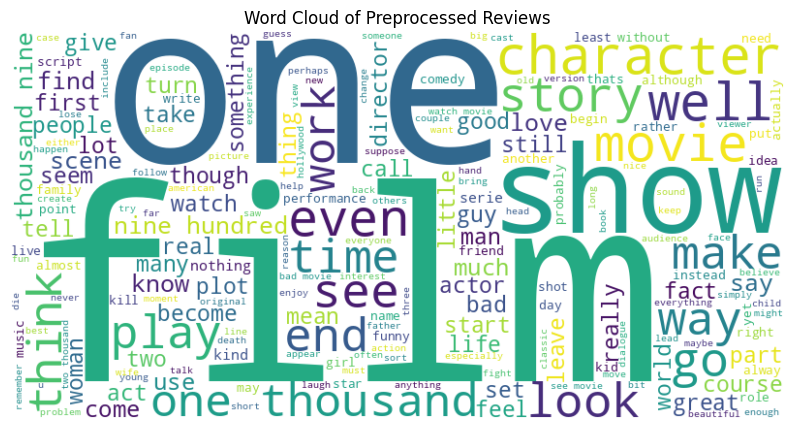

In [ ]:
# Combine all preprocessed review texts into a single string
preprocessed_text = df['review'].apply(lambda x: ' '.join(x))

# Create a WordCloud object
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(' '.join(preprocessed_text))

# Plot the WordCloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.title('Word Cloud of Preprocessed Reviews')
plt.axis('off')  # Turn off axis
plt.show()

*   Positive words:  Some positive words include "good," "great," "enjoyable," "funny," "acting," "performances," "recommend," and "suspenseful," which indicate that some viewers enjoyed the movie's acting, performances, and found it suspenseful.
*   Negative words: On the other hand, there are also negative words like "boring," "confusing," "disappointing," "predictable," "weak," "unoriginal," and "bad," which suggest that other viewers found the movie boring, confusing, disappointing, predictable, or otherwise lacking.

###**Top 5 most frequent words** **bold text**

In [ ]:
# Flatten the list of lists into a single list of tokens
tokenized_words = [word for sublist in df['review'] for word in sublist]

# Count the frequency of each word
word_counts = Counter(tokenized_words)

# Get the top 5 most frequent words
top_words = word_counts.most_common(5)

# Extract the words and their counts
top_words, top_counts = zip(*top_words)

# Plot the top 5 most frequent words
plt.figure(figsize=(10, 6))
plt.bar(top_words, top_counts, color='skyblue')
plt.title('Top 5 Most Frequent Words')
plt.xlabel('Words')
plt.ylabel('Frequency')
plt.xticks(rotation=45)
plt.show()

###**Top next 5 most frequent words** **bold text**

In [ ]:
# Get the next 5 most frequent words after the top 5
next_top_words = word_counts.most_common(10)[5:]
# Extract the words and their counts
next_top_words, next_top_counts = zip(*next_top_words)
# Plot the next 5 most frequent words
plt.figure(figsize=(10, 6))
plt.bar(next_top_words, next_top_counts, color='skyblue')
plt.title('Next 5 Most Frequent Words')
plt.xlabel('Words')
plt.ylabel('Frequency')
plt.xticks(rotation=45)
plt.show()

##**Unigrams, Bigrams, Trigrams, fourgrams**

In [ ]:
import nltk
from nltk.util import ngrams

# Assume df is your DataFrame containing the preprocessed text data

# Function to generate n-grams from a list of tokens
def generate_ngrams(tokens, n):
    return list(ngrams(tokens, n))

# Example usage
# Generate unigrams, bigrams, trigrams, and 4-grams for the first row in the DataFrame
index = 0
review_tokenized = df.loc[index, 'review']

# Unigrams
unigrams = generate_ngrams(review_tokenized, 1)
print("Unigrams:")
print(unigrams)

# Bigrams
bigrams = generate_ngrams(review_tokenized, 2)
print("\nBigrams:")
print(bigrams)

# Trigrams
trigrams = generate_ngrams(review_tokenized, 3)
print("\nTrigrams:")
print(trigrams)

# 4-grams (Example of n-gram with n = 4)
four_grams = generate_ngrams(review_tokenized, 4)
print("\n4-grams:")
print(four_grams)

Unigrams:
[('one',), ('reviewer',), ('mention',), ('watch',), ('one',), ('oz',), ('episode',), ('youll',), ('hook',), ('right',), ('exactly',), ('happen',), ('methe',), ('first',), ('thing',), ('strike',), ('oz',), ('brutality',), ('unflinching',), ('scene',), ('violence',), ('set',), ('right',), ('word',), ('go',), ('trust',), ('show',), ('faint',), ('hearted',), ('timid',), ('show',), ('pull',), ('punch',), ('regard',), ('drug',), ('sex',), ('violence',), ('hardcore',), ('classic',), ('use',), ('wordit',), ('call',), ('oz',), ('nickname',), ('give',), ('oswald',), ('maximum',), ('security',), ('state',), ('penitentary',), ('focus',), ('mainly',), ('emerald',), ('city',), ('experimental',), ('section',), ('prison',), ('cell',), ('glass',), ('front',), ('face',), ('inwards',), ('privacy',), ('high',), ('agenda',), ('em',), ('city',), ('home',), ('manyaryans',), ('muslims',), ('gangsta',), ('latino',), ('christian',), ('italian',), ('irish',), ('moreso',), ('scuffle',), ('death',), ('st

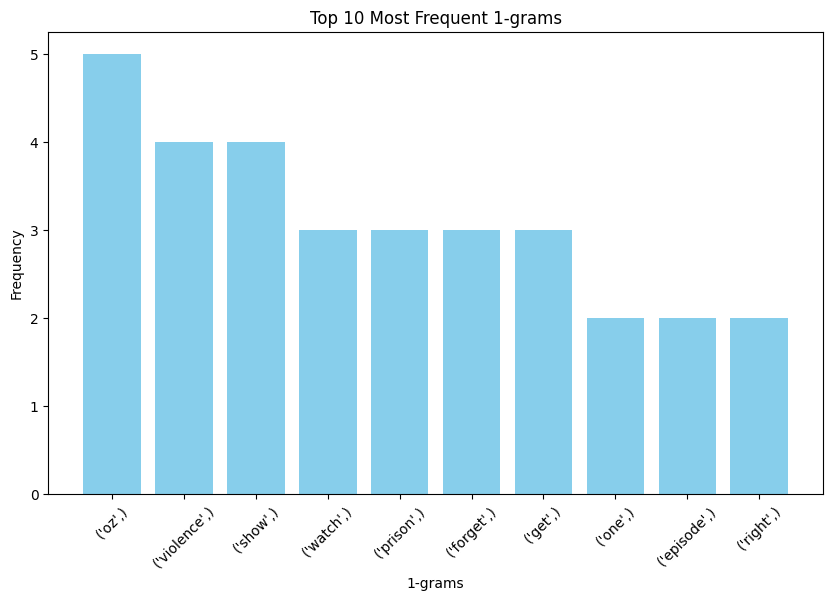

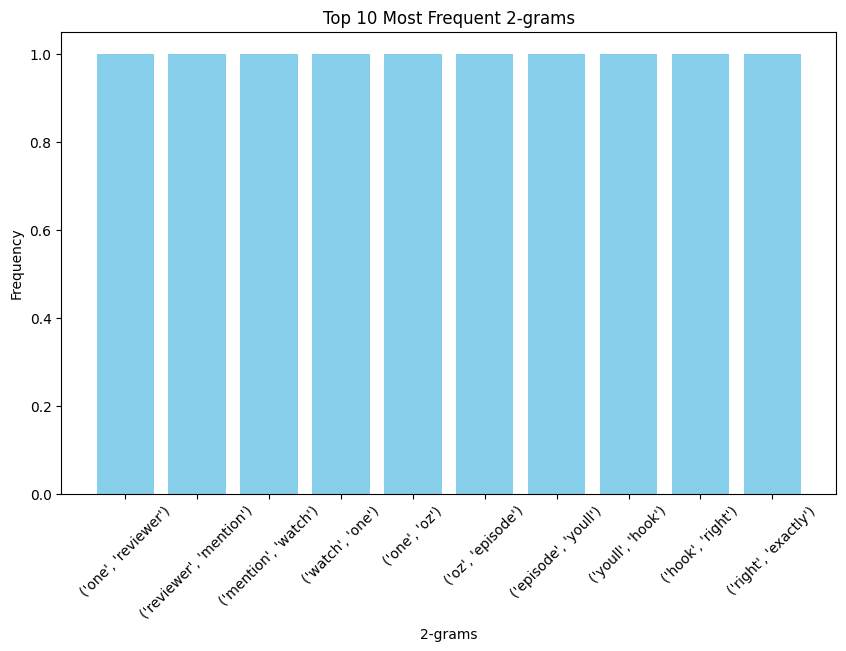

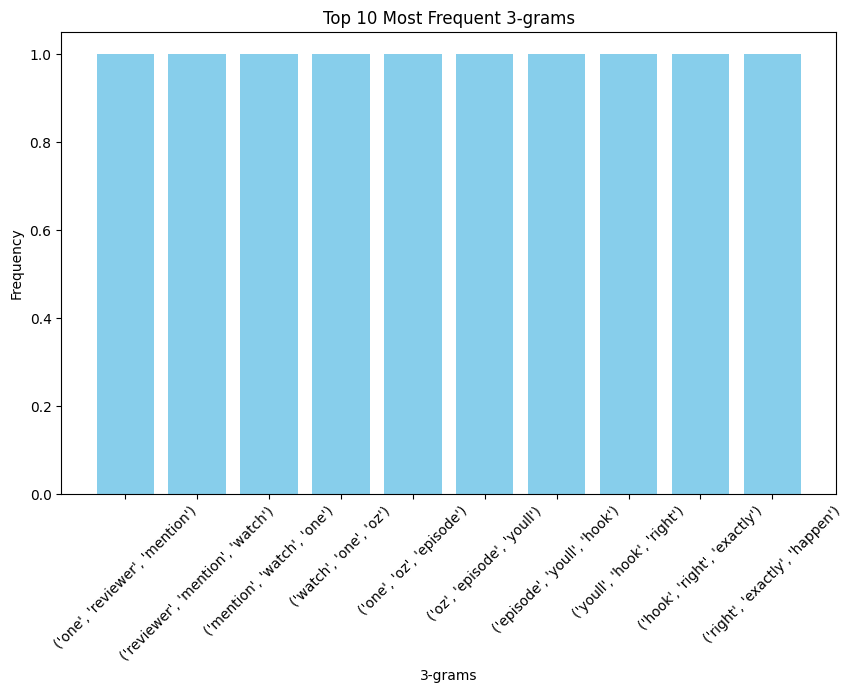

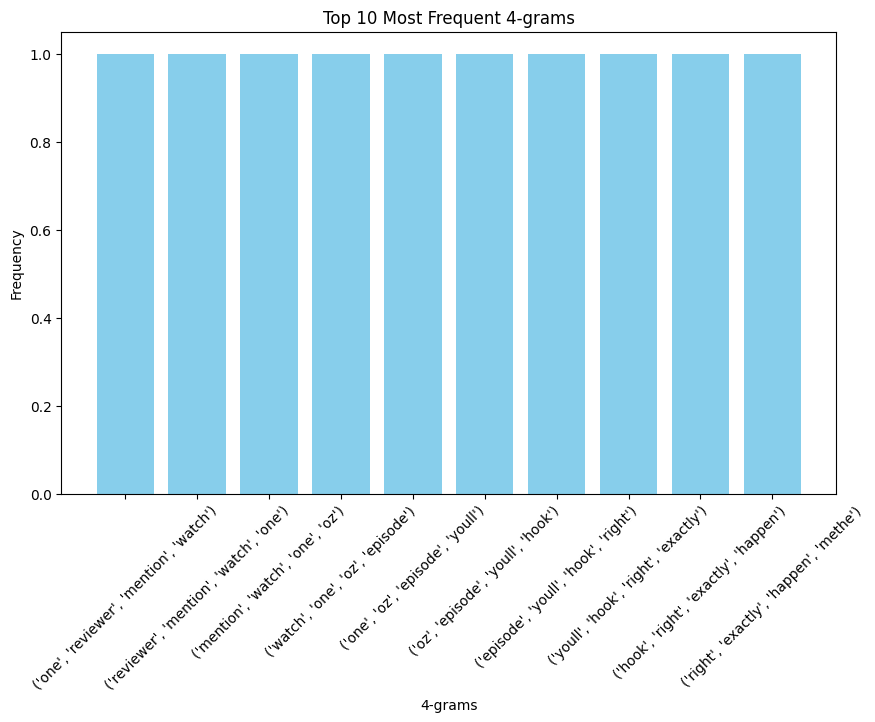

In [ ]:
# Function to generate n-grams from a list of tokens
def generate_ngrams(tokens, n):
    return list(ngrams(tokens, n))

# Function to plot the frequency distribution of n-grams
def plot_ngram_frequency_distribution(tokens, n, top_n=10):
    # Generate n-grams
    ngrams_list = generate_ngrams(tokens, n)
    # Count the frequency of each n-gram
    ngrams_counts = Counter(ngrams_list)
    # Get the top n most frequent n-grams
    top_ngrams = ngrams_counts.most_common(top_n)
    # Extract n-grams and their counts
    ngrams, counts = zip(*top_ngrams)

    # Convert n-grams to strings
    ngrams = [str(ngram) for ngram in ngrams]

    # Plot the frequency distribution
    plt.figure(figsize=(10, 6))
    plt.bar(ngrams, counts, color='skyblue')
    plt.title(f'Top {top_n} Most Frequent {n}-grams')
    plt.xlabel(f'{n}-grams')
    plt.ylabel('Frequency')
    plt.xticks(rotation=45)
    plt.show()

# Example usage
# Assume df is your DataFrame containing the preprocessed text data
index = 0
review_tokenized = df.loc[index, 'review']

# Plot frequency distribution for unigrams
plot_ngram_frequency_distribution(review_tokenized, 1)

# Plot frequency distribution for bigrams
plot_ngram_frequency_distribution(review_tokenized, 2)

# Plot frequency distribution for trigrams
plot_ngram_frequency_distribution(review_tokenized, 3)

# Plot frequency distribution for 4-grams
plot_ngram_frequency_distribution(review_tokenized, 4)

##**Feature Extraction**

In [ ]:
df.head()

,index,review,sentiment,review_length
0,0,"[one, reviewer, mention, watch, one, oz, episo...",positive,1761
1,1,"[wonderful, little, production, film, techniqu...",positive,998
2,2,"[think, wonderful, way, spend, time, hot, summ...",positive,926
3,3,"[basically, there, family, little, boy, jake, ...",negative,748
4,4,"[petter, matteis, love, time, money, visually,...",positive,1317


In [ ]:
# Convert tokenized and lemmatized text data into TF-IDF vectors
tfidf_vectorizer = TfidfVectorizer(ngram_range=(1, 3), max_features=5000)
X = df['review'].apply(lambda x: ' '.join(x))
X_tfidf = tfidf_vectorizer.fit_transform(X)

##**Label encoding for dependent variable**

In [ ]:
# Initialize the label encoder
label_encoder = LabelEncoder()
# Fit label encoder and transform sentiment labels to numeric values
y_numeric = label_encoder.fit_transform(df['sentiment'])
# Print the mapping of original labels to numeric values
label_mapping = {label: index for index, label in enumerate(label_encoder.classes_)}
print("Label Mapping:", label_mapping)
# Print the first few numeric labels
print("Numeric Labels:")
print(y_numeric[:5])

Label Mapping: {'negative': 0, 'positive': 1}
Numeric Labels:
[1 1 1 0 1]


##**Train test split**

In [ ]:
# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_tfidf, y_numeric, test_size=0.2, random_state=42)

##**Logistic Regression**

In [ ]:
# Initialize the logistic regression model
logreg_model = LogisticRegression(max_iter=1000)

In [ ]:
# Train the model
logreg_model.fit(X_train, y_train)

LogisticRegression(max_iter=1000)

###**Evaluation of Logistic Regression**

In [ ]:
# Predict the labels for the test set
y_pred = logreg_model.predict(X_test)

In [ ]:
# Calculate accuracy
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)

Accuracy: 0.8879


###**Confusion Matrix**

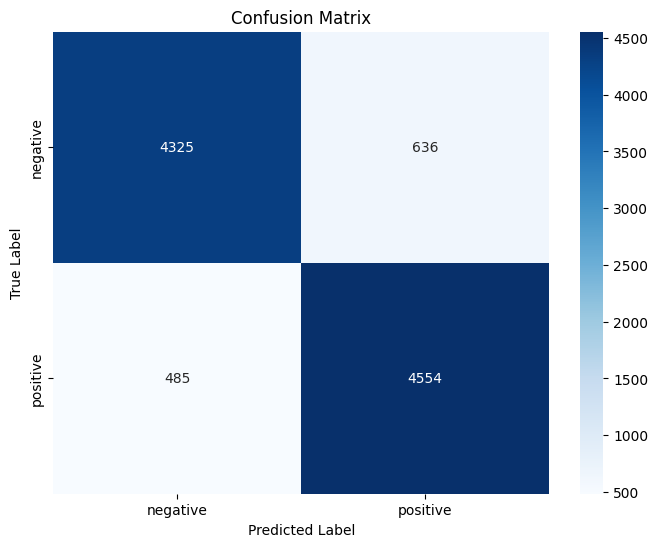

In [ ]:
# Confusion Matrix
conf_matrix = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=label_encoder.classes_, yticklabels=label_encoder.classes_)
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix')
plt.show()

###**ROC Curve**

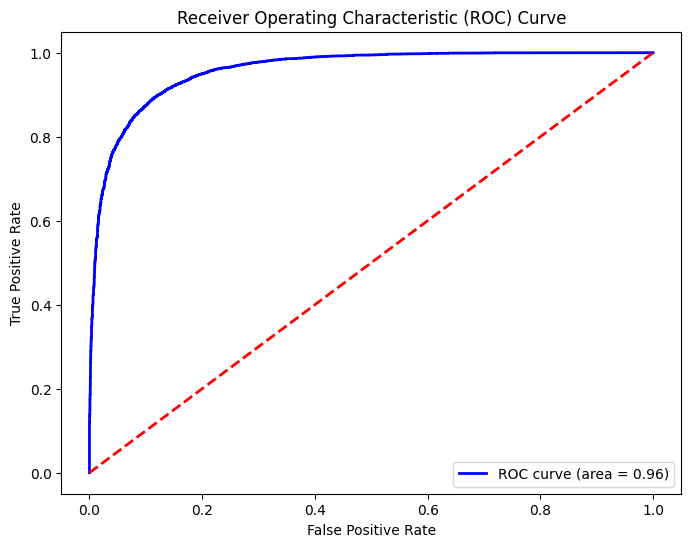

In [ ]:
# ROC Curve
y_prob = logreg_model.predict_proba(X_test)[:, 1]
fpr, tpr, thresholds = roc_curve(y_test, y_prob)
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', lw=2, label='ROC curve (area = %0.2f)' % roc_auc_score(y_test, y_prob))
plt.plot([0, 1], [0, 1], color='red', lw=2, linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc='lower right')
plt.show()

###**Classification Report**

In [ ]:
# Classification Report
class_report = classification_report(y_test, y_pred, target_names=label_encoder.classes_)
print("Classification Report:\n", class_report)

Classification Report:
               precision    recall  f1-score   support

    negative       0.90      0.87      0.89      4961
    positive       0.88      0.90      0.89      5039

    accuracy                           0.89     10000
   macro avg       0.89      0.89      0.89     10000
weighted avg       0.89      0.89      0.89     10000



##**Naive Bayes**

In [ ]:
naive_bayes_model = MultinomialNB()
naive_bayes_model.fit(X_train, y_train)a

MultinomialNB()

In [ ]:
#Make predictions on the test data
y_pred = naive_bayes_model.predict(X_test)

###**Evaluation of naive bayes model**

In [ ]:
#Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)

Accuracy: 0.887


###**confusion matrix**

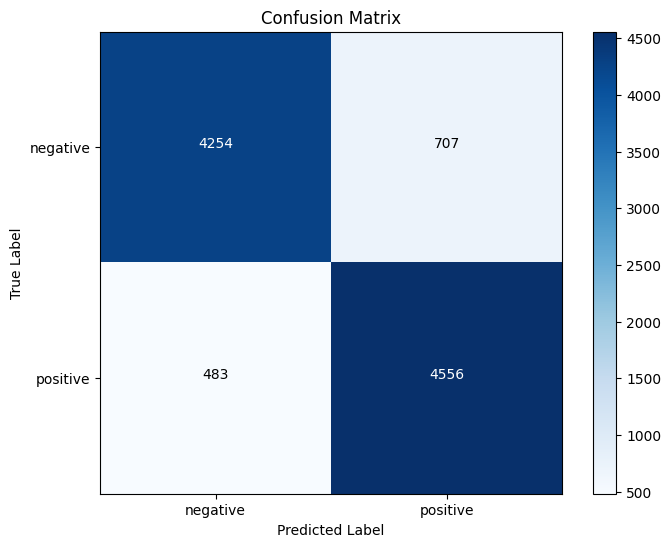

In [ ]:
# Plot confusion matrix
plt.figure(figsize=(8, 6))
plt.imshow(conf_matrix, interpolation='nearest', cmap=plt.cm.Blues)
plt.title('Confusion Matrix')
plt.colorbar()
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.xticks([0, 1], label_encoder.classes_)
plt.yticks([0, 1], label_encoder.classes_)
for i in range(conf_matrix.shape[0]):
    for j in range(conf_matrix.shape[1]):
        plt.text(j, i, format(conf_matrix[i, j], 'd'),
                 horizontalalignment="center",
                 color="white" if conf_matrix[i, j] > conf_matrix.max() / 2 else "black")
plt.show()

###**ROC curve and AUC**

In [ ]:
# Calculate ROC curve and AUC
fpr, tpr, thresholds = roc_curve(y_test, y_pred)
roc_auc = auc(fpr, tpr)

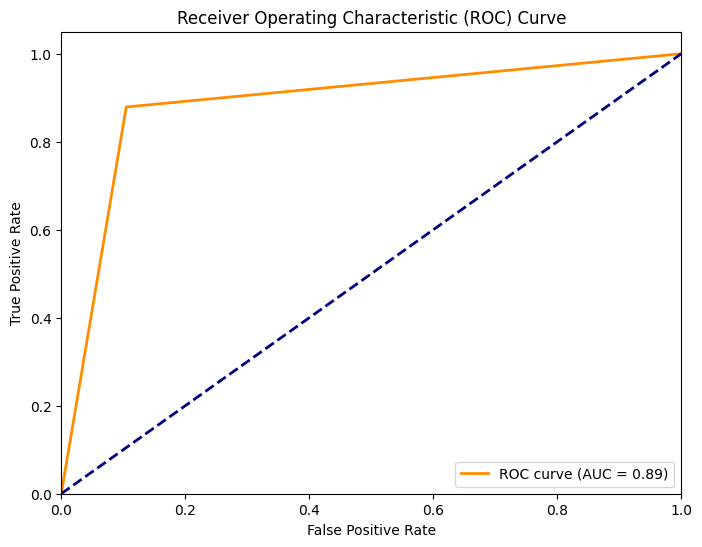

In [ ]:
# Plot ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (AUC = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc="lower right")
plt.show()

###**Classification Report**

In [ ]:
print("\nClassification Report:\n", class_report)


Classification Report:
               precision    recall  f1-score   support

    negative       0.90      0.86      0.88      4961
    positive       0.87      0.90      0.88      5039

    accuracy                           0.88     10000
   macro avg       0.88      0.88      0.88     10000
weighted avg       0.88      0.88      0.88     10000



###**Summary:**

The project involves sentiment analysis on the IMDb dataset, which comprises 50,000 movie reviews. The dataset is structured for binary sentiment classification, with 25,000 reviews designated for training and an additional 25,000 for testing. The objective is to predict the sentiment of movie reviews, distinguishing between positive and negative sentiments.

###**Approach:**

1. **Exploratory Data Analysis (EDA):** We analyzed the dataset to understand its characteristics. The analysis revealed an equal distribution of positive and negative sentiments, indicating a balanced dataset. Most reviews were observed to be relatively short, with shorter reviews being more frequent. Additionally, a WordCloud analysis highlighted common terms associated with positive and negative sentiments.

2. **Text Preprocessing:** We performed text preprocessing to clean and prepare the text data for modeling. This included removing unwanted characters, URLs, converting text to lowercase, tokenization, removing stopwords, and lemmatization. We also generated uni, bi, tri, and four-gram features from the text data.

3. **Feature Engineering:** We used TF-IDF vectorization to convert the text data into numerical features while preserving the importance of words in the documents. The target variable was encoded using label encoding.

4. **Model Training and Evaluation:** We trained logistic regression and multinomial naive Bayes models on the preprocessed data. Both models were evaluated using classification reports, which provided insights into precision, recall, and F1-score for each class (positive and negative sentiments). Based on the results, logistic regression performed better and was chosen as the final model.

###**Conclusion:**

The sentiment analysis project successfully developed a model capable of accurately predicting the sentiment of movie reviews. The logistic regression model achieved an accuracy of approximately 89%, with balanced performance across both positive and negative sentiments. The project highlights the effectiveness of natural language processing techniques and machine learning algorithms in analyzing textual data and extracting valuable insights. The developed model can be utilized in various applications, including market research, customer feedback analysis, and opinion mining in social media platforms, to gauge public sentiment towards movies. Overall, the project demonstrates the importance of sentiment analysis in understanding user opinions and preferences in the movie industry.